## Visualisation
This notebook is intended to visualise our data. We are interested in building a classifier which can tell the difference between case-reports and other articles. It's useful to first visualise our data so that we can see if any obvious, visible, difference does exist.

If not, that doesn't mean that our classifier won't work, but it's likely to be a harder project and this may give us some indication of the quality of our data for this task. 

The visualisation that comes out is a familiar view of Pubmed. There are 3 large clusters: 
- one large cluster for medical-related stuff, 
- another large research-focused cluster, 
- and a separate cluster for more social-sciency stuff

What we see here is that almost all of our case reports reside in our large medical cluster. Our non-case-reports are more evenly spread. This might represent a problem. We really want to tell the difference between case-reports and non-case-reports, we don't want to tell the difference between these large clusters. 

In [37]:
# !pip install umap-learn

In [38]:
%matplotlib inline
from gensim.corpora.mmcorpus import MmCorpus
from gensim.matutils import corpus2dense
import pandas as pd
import numpy as np
import umap
from matplotlib import pyplot as plt

In [40]:
import os
import json

In [41]:
data_dir = os.path.abspath(r'C:\Users\aday\OneDrive - SAGE Publishing\PROJECT_DATA\pubmed_case_report_classifier\data')
test_data_loc = os.path.join(data_dir,'test embeddings.json')
dev_data_loc = os.path.join(data_dir,'dev embeddings.json')
train_data_loc = os.path.join(data_dir,'train embeddings.json')

In [41]:
test = pd.read_csv(os.path.join(data_dir,'test.csv'), dtype=str)
train = pd.read_csv(os.path.join(data_dir,'train.csv'), dtype=str)
dev = pd.read_csv(os.path.join(data_dir,'dev.csv'), dtype=str)
train.shape, test.shape, dev.shape

((16974, 5), (2166, 5), (2140, 5))

In [42]:
with open(test_data_loc,'r') as f:
    test_embeddings = json.load(f)
with open(train_data_loc,'r') as f:
    train_embeddings  = json.load(f)
with open(dev_data_loc,'r') as f:
    dev_embeddings  = json.load(f)
len(train_embeddings), len(test_embeddings), len(dev_embeddings)

(16974, 2166, 2140)

## We have some embedings missing, so lets ensure that we filter those out

In [43]:
train = train.drop_duplicates(subset=['doi'], keep = 'first')
test = test.drop_duplicates(subset=['doi'], keep = 'first')
dev = dev.drop_duplicates(subset=['doi'], keep = 'first')

In [44]:
dev = dev[dev['doi'].isin(dev_embeddings)]
test = test[test['doi'].isin(test_embeddings)]
train = train[train['doi'].isin(train_embeddings)]
train.shape, test.shape, dev.shape

((16974, 5), (2166, 5), (2140, 5))

In [45]:
assert train.shape[0] == len(train_embeddings)
assert dev.shape[0] == len(dev_embeddings)
assert test.shape[0] == len(test_embeddings)

## combine train and dev sets

In [46]:
train.head(2)

,doi,articletitle,abstract,tiabs,casereport
0,10.1007/s10388-020-00767-0,Preoperative computed tomography predicts the ...,Recurrent laryngeal nerve paralysis (RLNP) aft...,Preoperative computed tomography predicts the ...,0
1,10.1167/19.7.2,Dynamic combination of position and motion inf...,"To accurately foveate a moving target, the ocu...",Dynamic combination of position and motion inf...,0


In [47]:
import numpy as np
y_train = np.array([float(x) for x in train['casereport'].values]).T
x_train = np.array([train_embeddings[doi] for doi in train.doi.tolist()])
y_dev = np.array([float(x) for x in dev['casereport'].values]).T
x_dev = np.array([dev_embeddings[doi] for doi in dev.doi.tolist()])
np.shape(y_train), np.shape(x_train),np.shape(y_dev), np.shape(x_dev)

((16974,), (16974, 768), (2140,), (2140, 768))

In [48]:
%%time
df = train

Wall time: 0 ns


In [49]:
X = x_train
np.shape(X)    

(16974, 768)

# uMap

In [50]:
%%time
import warnings
warnings.filterwarnings('ignore')

trans = umap.UMAP().fit(X)

Wall time: 9.6 s


# Add a colours column

In [51]:
colours = []
for x in df['casereport'].tolist():
    if x=='1':
        colours.append('red')
    elif x=='0':
        colours.append('green')
#     else:
#         colours.append('blue')
len(colours)

df['colour'] = colours

In [52]:
len(colours), df.shape, np.shape(X)

(16974, (16974, 6), (16974, 768))

In [53]:
df.head(2)

,doi,articletitle,abstract,tiabs,casereport,colour
0,10.1007/s10388-020-00767-0,Preoperative computed tomography predicts the ...,Recurrent laryngeal nerve paralysis (RLNP) aft...,Preoperative computed tomography predicts the ...,0,green
1,10.1167/19.7.2,Dynamic combination of position and motion inf...,"To accurately foveate a moving target, the ocu...",Dynamic combination of position and motion inf...,0,green


# Quick visualise with MatplotLib

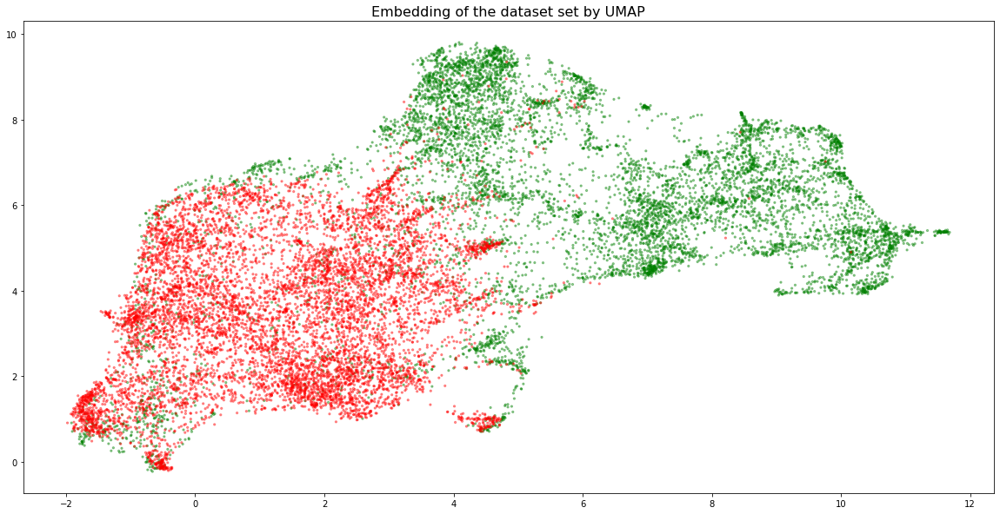

In [54]:
fig, ax = plt.subplots(figsize=(20, 10))
plt.scatter(trans.embedding_[:, 0], 
            trans.embedding_[:, 1], 
            s= 5, 
            c=colours, 
            cmap='Spectral',
           alpha = 0.4)
plt.title('Embedding of the dataset set by UMAP', fontsize=16);
plt.savefig('outputs/umap_plt.png')

## Bokeh code - slower visualisation with more interactive options
The first step is to define a few things that will go into the plot.

#### Hover tool
The hover tool defines what happens when you hover your mouse over the plot. 

In [55]:
from bokeh.plotting import *
# from bokeh.models import ColumnDataSource, OpenURL, TapTool
from bokeh.models import *
from bokeh.io import output_notebook

In [57]:
hover = HoverTool(
        tooltips=[
            ("DOI", "@doi"),
            ("Title","@articletitle"),
                ])

In [58]:
output_notebook()

Loading BokehJS ...

In [59]:
TOOLS = [BoxSelectTool(), hover, 'tap','box_zoom','reset', 'crosshair'] #,HoverTool()] # just say 'HoverTool()' for the default

In [60]:
# set alpha
df['Alpha'] = 0.4

## Build plot
This is where we define the figure itself using the Bokeh package.

In [61]:
from bokeh.io import show
from bokeh.models import ColumnDataSource
from bokeh.palettes import RdBu3
from bokeh.plotting import figure

# https://stackoverflow.com/questions/41856999/bokeh-plots-just-bring-up-a-blank-window
# BOKEH_RESOURCES=inline
plot_title = 'Bokeh plot of SPECTER casereport data'

# plotting
p = figure(plot_width=950, plot_height=600,
           title=plot_title,  # specified in the config file!
           tools=TOOLS,
          x_axis_label = "Textual similarity axis_1 (arbitrary units)",
          y_axis_label = 'Textual similarity axis_2 (arbitrary units)') # , active_inspect=None)

# p.toolbar.active_inspect = ['crosshair', hover]

p.background_fill_color = "black"

df['x'] = trans.embedding_[:, 0]
df['y'] = trans.embedding_[:, 1]
p.circle(x = 'x' , 
         y = 'y', 
#           legend = 'Division',
         size = 6, # 'Sizes',
         color = 'colour',
         alpha = 'Alpha', 
         line_alpha = 0,
         source = ColumnDataSource(df))  # This conversion to ColumnDataSource is crucial.

p.legend.location = "bottom_right"
# p.legend.text = div_colors

output_file('outputs/bokeh.html',
           mode = 'inline')  # toggle for write-to-file


# add links
# url = "@Link"
# taptool = p.select(type=TapTool)
# taptool.callback = OpenURL(url=url)

In [62]:
show(p)